In [60]:
import pickle

import pyodbc
import numpy as np
import pandas as pd
import openpyxl
import math
import matplotlib.pyplot as plt
import seaborn as sns
from sqlalchemy import create_engine
from scipy.stats import poisson, expon
from sklearn.model_selection import train_test_split
import xgboost as xgb
from xgboost import XGBClassifier
from sklearn.metrics import mean_absolute_error, mean_poisson_deviance
import ast
from xgboost import XGBRegressor
from sklearn.model_selection import RandomizedSearchCV
import json
import joblib
from sklearn.preprocessing import LabelEncoder
from collections import defaultdict
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.metrics import classification_report
from xgboost import plot_importance

In [2]:
# to be able to see multiple outputs from single cell
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [3]:
server = "小语"      
database = "YRT_Transit_Export"
driver = "SQL Server"
trusted_connection_string = "yes" 

username = "小语/mao75"
password = ""

# table names that you set up after data import ffrom backup file / flat files in SQL SSMS
table_a = 'dbo.E_TRP_INT_COMBINE'  
table_b = 'dbo.TRN_YRT_TRP_D_BOARDPERIODS'  
table_c = 'dbo.S_STOPS_INIT'    
table_d = 'dbo.yrt_d_time' 

In [4]:

connection_string = f"mssql+pyodbc://{server}/{database}?trusted_connection={trusted_connection_string}&driver={driver}"
engine = create_engine(connection_string)
def getdata(connection_string,columns,engine,line_number):
    # Fetch column names for the table
    #query_columns = f"""
    #SELECT COLUMN_NAME
    #FROM INFORMATION_SCHEMA.COLUMNS
    #WHERE TABLE_SCHEMA = 'dbo' AND TABLE_NAME = 'E_TRP_INT_COMBINE'
    #"""
    #columns_df = pd.read_sql(query_columns, con=engine)
    #columns = columns_df["COLUMN_NAME"].tolist()  # List of column names
    
    # Initialize an empty list to store individual column DataFrames
    dfs = []
    
    # Loop through columns and fetch data for each
    for column in columns:
        sql_query = f"SELECT {column} FROM {table_a} where LINEABBR='{line_number}'"
        print(f"Fetching data for column: {column}")
        df_column = pd.read_sql(sql_query, con=engine)
        df_column.columns = [column]  # Ensure column name matches
        dfs.append(df_column)
    
    # Combine all column DataFrames into a single DataFrame
    final_df = pd.concat(dfs, axis=1)
    
    # Display the combined DataFrame
    print(final_df.head(10))
    return final_df

In [5]:
sql_query = "SELECT * FROM dbo.yrt_d_time"
df_dtime = pd.read_sql(sql_query, con=engine)
sql_query = "SELECT * FROM dbo.TRN_YRT_TRP_D_BOARDPERIODS"
df_boardperiod = pd.read_sql(sql_query, con=engine)
sql_query = "SELECT * FROM dbo.S_STOPS_INIT"
df_stops = pd.read_sql(sql_query, con=engine)

In [ ]:
sql_query = "SELECT * FROM dbo.E_TRP_INT_COMBINE WHERE LINEABBR='601'"
df_601=pd.read_sql(sql_query, con=engine)

In [ ]:
df_601.to_parquet("df_601.parquet", engine="pyarrow", compression="snappy")

In [ ]:
sql_query = "SELECT * FROM dbo.E_TRP_INT_COMBINE WHERE LINEABBR='603'"
df_603=pd.read_sql(sql_query, con=engine)

In [ ]:
df_603.to_parquet("df_603.parquet", engine="pyarrow", compression="snappy")

In [ ]:
sql_query = "SELECT * FROM dbo.E_TRP_INT_COMBINE WHERE LINEABBR='050'"
df_050=pd.read_sql(sql_query, con=engine)

In [ ]:
df_050.to_parquet("df_050.parquet", engine="pyarrow", compression="snappy")

In [ ]:
sql_query = "SELECT * FROM dbo.E_TRP_INT_COMBINE WHERE LINEABBR='096'"
df_096=pd.read_sql(sql_query, con=engine)

In [ ]:
df_096.to_parquet("df_096.parquet", engine="pyarrow", compression="snappy")

In [ ]:
sql_query = "SELECT * FROM dbo.E_TRP_INT_COMBINE WHERE LINEABBR='605'"
df_605=pd.read_sql(sql_query, con=engine)

In [ ]:
df_605.to_parquet("df_605.parquet", engine="pyarrow", compression="snappy")

In [ ]:
sql_query = "SELECT * FROM dbo.E_TRP_INT_COMBINE WHERE LINEABBR='607'"
df_607=pd.read_sql(sql_query, con=engine)

In [ ]:
df_607.to_parquet("df_607.parquet", engine="pyarrow", compression="snappy")

In [6]:
#Time Formula:
def fn_HH24MM(time_sec):
    try:
        # Try to convert the input to a float
        time_sec = float(time_sec)
    except (ValueError, TypeError):
        # If conversion fails, return None
        return None
    # Calculate hours, minutes, and seconds
    if math.isnan(time_sec):
        return None
    else:
        hours = math.floor(time_sec / 3600)
        minutes = math.floor((time_sec % 3600) / 60)
        seconds = math.floor(time_sec % 60)
       
        # Format the time as HH:MM:SS
        time_hhmm = f"{hours:02}:{minutes:02}:{seconds:02}"
       
        return time_hhmm

In [15]:
columns_to_keep = [
    'LINEABBR', 'SIGNID', 'OPD_DATE', 'SERVICEGROUPABBR', 'BLOCK',
    'BLOCKID_TRP', 'BLOCK_ID_INT', 'PATTERN', 'DIRECTION',
    'TRIPID_TRP', 'TRIPID_INT', 'TRIP_ID_INT', 'TRIP_CODE',
    'SCHED_DISTANCE', 'ACT_DISTANCE', 'DISTANCE_TO_NEXT', 'SCHED_SPEED',
    'ACT_SPEED', 'POINT_COUNT', 'POINT_FIRST', 'POINT_LAST', 'DRIVER_ID','EVENT_NO_TRIP', 'ETIME',
    'SEQUENCE', 'STOPABBR', 'NODEABBR', 'NODE_SEQ', 'NODEID', 'DOORS_OPENING', 
    'MISSED_TRIP', 'MISSED_STOP', 'IS_ADDITIONAL', 'COMPLETENESS', 'VEHICLE_ID',
    'VEHICLE', 'SEATS', 'CAPACITY', 'CAPACITY_MAX', 'LOAD', 'LOAD_VALID', 
    'LOAD_EXTRA', 'BOARDING', 'BOARDING_VALID', 'APC', 'APC_QUALITY', 
    'ALIGHTING', 'ALIGHTING_VALID', 'SCHED_START_TIME',
    'SCHED_END_TIME', 'SCHED_TRIP_TIME', 'ACT_ARR_TIME', 'ACT_DEP_TIME', 
    'ACT_START_TIME', 'ACT_END_TIME', 'ACT_TRIP_TIME', 'DWELL_TIME', 
    'GPS_LATITUDE', 'GPS_LONGITUDE', 'TERMINAL', 'LAYOVER',"EXCCOMBOID","EXCCOMBOABBR"
]

In [7]:
line_601 = pd.read_parquet("df_601.parquet", engine="pyarrow")

In [8]:
line_601["OPD_DATE"] = pd.to_datetime(line_601["OPD_DATE"])

In [9]:
line_601.shape

(6532932, 109)

In [10]:
lineabbr_values = ["601", "603", "050", "096", "605", "607"]

In [9]:
route_601_2024_1_1= line_601[line_601['OPD_DATE'] == '2024-01-01']

In [33]:
route_601_2024_1=line_601[line_601["OPD_DATE"].dt.month==1]

In [66]:
route_601_2024=line_601[line_601["OPD_DATE"].dt.year==2024]

In [ ]:
route_601_2024_1["OPD_DATE"].dt.year.value_counts()

In [ ]:
route_601_2024_1_1_sorted = route_601_2024_1_1.sort_values(by=["TRIPID_TRP","SCHED_DISTANCE","OPD_DATE","STOPABBR"])

In [ ]:
route_601_2024_1_1_sorted.to_excel("route_601_2024_1_1.xlsx", index=False)

In [ ]:
route_601_2024_1_1_sorted[route_601_2024_1_1_sorted["STOPABBR"]=="9794"]

In [ ]:
df_stops_norm=df_stops.copy()
df_stops_norm["LAT"] = df_stops_norm["LAT"] / 100
df_stops_norm["LON"] = df_stops_norm["LON"] / 100
df_stops_norm["LAT"].describe()


In [ ]:
df_stops[df_stops['STOPABBR'].isin(["7321","9779"])]

In [ ]:
len(df_stops["STOPABBR"].unique())

In [ ]:
North_601=[9769,9770,9771,9773,9775,9723,9777,9779,9781,9783,9785,9787,9789,9790,9792,9823,9794,9839,9796,9798,9800,9802,9804,9826,9806,9818,9882,9809]
Line_601_Stop={}
for stop in North_601:
    Line_601_Stop[stop]=df_stops[df_stops['STOPABBR']==f"{stop}"]["STOPNAME"]
Line_601_Stop

In [ ]:
route_601_2024_1_1[["GPS_LATITUDE","GPS_LONGITUDE"]].isnull().mean()

In [ ]:
def truncate(x, decimals=3):
    return int(x * (10 ** decimals)) / (10 ** decimals)


In [ ]:
route_601_2024_1_1_clean=route_601_2024_1_1.dropna(subset=["GPS_LATITUDE", "GPS_LONGITUDE"])

In [ ]:
route_601_2024_1_1_clean.loc[:,"GPS_LATITUDE"]=route_601_2024_1_1_clean["GPS_LATITUDE"].apply(truncate)
route_601_2024_1_1_clean.loc[:,"GPS_LONGITUDE"]=route_601_2024_1_1_clean["GPS_LONGITUDE"].apply(truncate)

In [ ]:
route_601_2024_1_1_clean[["GPS_LATITUDE","GPS_LONGITUDE"]]

In [ ]:
df_stops_toronto_GTA=df_stops[df_stops['CITY'].isin(["TORONTO","RICHMOND HILL","NEWMARKET", "MARKHAM"])]
df_stops_toronto_GTA=df_stops_toronto_GTA[["STOPABBR","STOPNAME","LAT","LON"]]
df_stops_toronto_GTA['STOPABBR']=df_stops_toronto_GTA['STOPABBR'].astype(int)

In [ ]:
df_stops_toronto_GTA

In [ ]:
df_stops_toronto_GTA.loc[:,"LAT"]=df_stops_toronto_GTA["LAT"]/10000
df_stops_toronto_GTA.loc[:,"LON"]=df_stops_toronto_GTA["LON"]/10000
df_stops_toronto_GTA.loc[:,"LAT"]=df_stops_toronto_GTA["LAT"].apply(truncate)
df_stops_toronto_GTA.loc[:,"LON"]=df_stops_toronto_GTA["LON"].apply(truncate)
df_stops_toronto_GTA[["LAT","LON"]]
df_stops_toronto_GTA.rename(columns={"STOPABBR":"STOPABBR_FIND"},inplace=True)

In [ ]:
df_stops_toronto_GTA_601_North = df_stops_toronto_GTA[df_stops_toronto_GTA["STOPABBR_FIND"].isin(North_601)]
df_stops_toronto_GTA_601_North

In [ ]:
df_stops_toronto_GTA_601_North= df_stops_toronto_GTA_601_North.rename(columns={
    "LAT": "GPS_LATITUDE",
    "LON": "GPS_LONGITUDE"
})

In [ ]:
df_merged = pd.merge(route_601_2024_1_1_clean,df_stops_toronto_GTA_601_North[["GPS_LATITUDE","GPS_LONGITUDE","STOPABBR_FIND","STOPNAME"]],on = ["GPS_LATITUDE","GPS_LONGITUDE"],how="left")

In [ ]:
df_merged[["STOPABBR_FIND","STOPABBR"]]

In [18]:
def passenger_data_processing(df,stop_number):
    df=df[df["ACT_ARR_TIME"].notna()].copy()
    df.loc[:,"ACT_ARR_TIME_M"]=df["ACT_ARR_TIME"]
    df.loc[:,"ACT_ARR_TIME_M"]=df["ACT_ARR_TIME_M"].apply(fn_HH24MM)
    df_stop=df[df["STOPABBR"]==f'{stop_number}'].copy()
    df_stop["datetime"]=df.apply(parse_time_with_date,axis=1)
    df_stop["datetime"]=pd.to_datetime(df_stop["datetime"])
    df_stop["hour"]=df_stop["datetime"].dt.hour
    df_stop["day_of_week"]=df_stop["datetime"].dt.dayofweek
    df_stop["month"]=df_stop["datetime"].dt.month
    df_stop['is_weekday'] = df_stop['day_of_week'].apply(lambda x: 1 if x < 5 else 0)
    df_15min = df_stop.set_index("datetime").resample("15min").agg({
    'BOARDING': 'sum',
    "ALIGHTING":"sum",
    'is_weekday':'max'
    }).reset_index()
    return df_15min
    
    
    
    
    
    

In [19]:
def parse_time_with_date(row):
    """
    将日期和超过24小时的时间合并为合法的datetime
    输入示例：date="2023-10-01", time="25:30:00"
    输出示例：pd.Timestamp("2023-10-02 01:30:00")
    """
    # 预处理时间字符串（兼容中文符号）
    time_str = str(row["ACT_ARR_TIME_M"])
    
    try:
        # 分割时间部分
        parts = list(map(int, time_str.split(":")))
        if len(parts) == 2:
            hours, minutes = parts
            seconds = 0
        elif len(parts) == 3:
            hours, minutes, seconds = parts
        else:
            raise ValueError("Invalid time format")
        
        # 计算超出24小时的天数和剩余时间
        days_add = hours // 24
        hours_remain = hours % 24
        
        # 生成正确的时间字符串
        corrected_time = f"{hours_remain:02d}:{minutes:02d}:{seconds:02d}"
        
        # 生成基准日期时间
        base_date = pd.to_datetime(row["OPD_DATE"]) + pd.DateOffset(days=days_add)
        return pd.to_datetime(f"{base_date.date()} {corrected_time}")
    
    except Exception as e:
        print(f"解析失败：OPD_DATE={row.get('OPD_DATE')}, ACT_ARR_TIME_M={row.get('ACT_ARR_TIME_M')}, 错误={e}")
        return pd.NaT  

In [7]:
unique_stop_601=route_601_2024_1["STOPABBR"].unique()
unique_stop_601_filtered=np.array([x for x in unique_stop_601 if isinstance(x,str) and x.startswith("9")])

NameError: name 'route_601_2024_1' is not defined

In [36]:
unique_stop_601_filtered

array(['9779', '9802', '9804', '9806', '9787', '9723', '9826', '9882',
       '9769', '9771', '9809', '9839', '9775', '9823', '9792', '9790',
       '9777', '9808', '9817', '9789', '9785', '9770', '9783', '9774',
       '9803', '9776', '9778', '9824', '9797', '9781', '9796', '9819',
       '9772', '9791', '9883', '9807', '9784', '9793', '9805', '9780',
       '9782', '9788', '9795', '9786', '9799', '9800', '9794', '9798',
       '9773', '9818', '9825', '9840', '9801'], dtype='<U4')

In [37]:
df_15min=passenger_data_processing(route_601_2024_1,unique_stop_601_filtered[8])
df_15min.head(20)

C:\Users\mao75\AppData\Local\Temp\ipykernel_22200\1549121403.py:4: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['18:28:13' '19:02:59' '19:04:50' ... '08:08:39' '09:12:34' '08:22:40']' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.loc[:,"ACT_ARR_TIME_M"]=df["ACT_ARR_TIME_M"].apply(fn_HH24MM)


,datetime,BOARDING,ALIGHTING,is_weekday
0,2023-01-01 06:00:00,27.0,0.0,0.0
1,2023-01-01 06:15:00,18.0,0.0,0.0
2,2023-01-01 06:30:00,0.0,0.0,NaN
3,2023-01-01 06:45:00,7.0,0.0,0.0
4,2023-01-01 07:00:00,12.0,0.0,0.0
5,2023-01-01 07:15:00,4.0,0.0,0.0
6,2023-01-01 07:30:00,0.0,0.0,NaN
7,2023-01-01 07:45:00,22.0,0.0,0.0
8,2023-01-01 08:00:00,13.0,0.0,0.0
9,2023-01-01 08:15:00,0.0,24.0,0.0


<Axes: title={'center': '每小时总上车人数'}, xlabel='hour'>

Text(0.5, 0, 'hour')

Text(0, 0.5, 'loading')

C:\Users\mao75\Desktop\study\Rotman\Python\pythonProject\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 27599 (\N{CJK UNIFIED IDEOGRAPH-6BCF}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\mao75\Desktop\study\Rotman\Python\pythonProject\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 23567 (\N{CJK UNIFIED IDEOGRAPH-5C0F}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\mao75\Desktop\study\Rotman\Python\pythonProject\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 26102 (\N{CJK UNIFIED IDEOGRAPH-65F6}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\mao75\Desktop\study\Rotman\Python\pythonProject\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 24635 (\N{CJK UNIFIED IDEOGRAPH-603B}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\mao75\Desktop\study\Rotman\

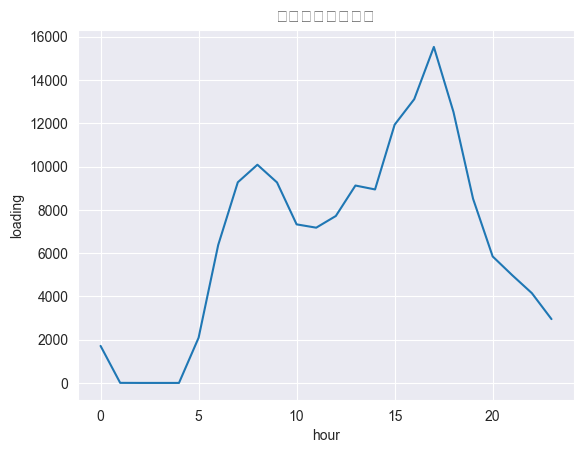

In [38]:
df_15min["hour"] = pd.to_datetime(df_15min["datetime"]).dt.hour

df_15min.groupby("hour")["BOARDING"].sum().plot(kind="line", title="每小时总上车人数")
plt.xlabel("hour")
plt.ylabel("loading")
plt.grid(True)
plt.show()

In [20]:
stop_601 = []
for i in line_601["STOPABBR"].unique():
    if i in df_stops["STOPABBR"].unique():
        stop_601.append(i)
stop_601

['9779',
 '9802',
 '9804',
 '9806',
 '9787',
 '9723',
 '9826',
 '9882',
 '9769',
 '9771',
 '9809',
 '9839',
 '9775',
 '9823',
 '9792',
 '9790',
 '9777',
 '9808',
 '9817',
 '9789',
 '9785',
 '9770',
 '9783',
 '9774',
 '9803',
 '9776',
 '9778',
 '9824',
 '9797',
 '9781',
 '9796',
 '9819',
 '9772',
 '9791',
 '9883',
 '9807',
 '9784',
 '9793',
 '9805',
 '9780',
 '9782',
 '9788',
 '9795',
 '9786',
 '9799',
 '9800',
 '9794',
 '9798',
 '9773',
 '9818',
 '9825',
 '9840',
 '9801']

In [26]:
def parse_time_with_date(row):
    time_str = str(row["ACT_ARR_TIME_M"])
    try:
        parts = list(map(int, time_str.split(":")))
        hours, minutes = parts[0], parts[1]
        seconds = parts[2] if len(parts) == 3 else 0
        days_add = hours // 24
        hours_remain = hours % 24
        corrected_time = f"{hours_remain:02d}:{minutes:02d}:{seconds:02d}"
        base_date = pd.to_datetime(row["OPD_DATE"]) + pd.DateOffset(days=days_add)
        return pd.to_datetime(f"{base_date.date()} {corrected_time}")
    except Exception:
        return pd.NaT

In [27]:

def assign_period(hour):
    if 0 <= hour < 6:
        return 0
    elif 6 <= hour < 9:
        return 1
    elif 9 <= hour < 15:
        return 2
    elif 15 <= hour < 19:
        return 3
    elif 19<= hour <22:
        return 4
    else:
        return 5



In [23]:
def aggregate_by_15min(df):
    df = df[df["ACT_ARR_TIME"].notna()].copy()
    df["ACT_ARR_TIME_M"] = df["ACT_ARR_TIME"].apply(fn_HH24MM)
    df["datetime"] = df.apply(parse_time_with_date, axis=1)
    df = df[df["datetime"].notna()].copy()

    df["pattern_id"] = df["PATTERN"].astype(str)
    df["stop_id"] = df["STOPABBR"].astype(str)
    df["month"] = df["datetime"].dt.month
    df["day_of_week"] = df["datetime"].dt.dayofweek
    df["hour"] = df["datetime"].dt.hour
    df["period"] = df["hour"].apply(assign_period)
    df["is_weekday"] = df["day_of_week"].apply(lambda x: 1 if x < 5 else 0)
    df["datetime_15min"] = df["datetime"].dt.floor("15min")

    agg_df = df.groupby([
        "pattern_id", "stop_id", "datetime_15min", "month", "period", "is_weekday"
    ]).agg({
        "BOARDING": "sum","ALIGHTING": "sum"
    }).reset_index()

    return agg_df

In [53]:
def train_and_generate_lambdas(df_raw):
    df = aggregate_by_15min(df_raw)

    le_pattern = LabelEncoder()
    le_stop = LabelEncoder()
    df["pattern_encoded"] = le_pattern.fit_transform(df["pattern_id"])
    df["stop_encoded"] = le_stop.fit_transform(df["stop_id"])

    features = ["pattern_encoded", "stop_encoded", "month", "period", "is_weekday"]
    X = df[features]
    y = df["BOARDING"]

    model = XGBRegressor(objective="count:poisson", n_estimators=100,learning_rate=0.1,max_depth=3)
    model.fit(X, y)

    # Generate all combinations
    result = {}
    existing_pairs = df[["pattern_id", "stop_id"]].drop_duplicates()
    for _, row in existing_pairs.iterrows():
        p = row["pattern_id"]
        s = row["stop_id"]
        p_code = le_pattern.transform([p])[0]
        s_code = le_stop.transform([s])[0]
    
        if p not in result:
            result[p] = {}
        result[p][s] = {}
    
        for m in range(1, 13):
            result[p][s][str(m)] = {}
            for d in range(1, 32):
                result[p][s][str(m)][str(d)] = {}
                for per in range(6):
                    test_input = pd.DataFrame([{
                        "pattern_encoded": p_code,
                        "stop_encoded": s_code,
                        "month": m,
                        "period": per,
                        "is_weekday": 1
                    }])
                    lambda_pred = float(model.predict(test_input)[0])
                    result[p][s][str(m)][str(d)][str(per)] = lambda_pred


    # Save results
    with open("line_601_lambda_predictions.json", "w") as f:
        json.dump(result, f, indent=2)

    joblib.dump(model, "line_601_lambda_model.pkl")
    joblib.dump(le_pattern, "line_601_pattern_encoder.pkl")
    joblib.dump(le_stop, "line_601_stop_encoder.pkl")

    return result

In [54]:
line_601.head()

,ID,SIGNID,OPD_DATE,WEEKDAY,DIVISIONID,DIVISIONABBR,SERVICEGROUPID,SERVICEGROUPABBR,EXCCOMBOID,EXCCOMBOABBR,...,Pkg_Exec_GUID,CreatedDate,LastModifiedDate,CTE,POINT_IDX_C,DWELLTIME,POINT_F,POINT_L,TERMINAL,LAYOVER
0,5286840160,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
1,5286840161,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
2,5286840162,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
3,5286840163,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
4,5286840164,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None


In [55]:
line_601_filtered=line_601[line_601["STOPABBR"].isin(stop_601)].copy()
train_and_generate_lambdas(line_601_filtered)

{'601001': {'9723': {'1': {'1': {'0': 4.3154778480529785,
     '1': 7.934519290924072,
     '2': 7.934519290924072,
     '3': 10.452556610107422,
     '4': 8.261570930480957,
     '5': 6.880866050720215},
    '2': {'0': 4.3154778480529785,
     '1': 7.934519290924072,
     '2': 7.934519290924072,
     '3': 10.452556610107422,
     '4': 8.261570930480957,
     '5': 6.880866050720215},
    '3': {'0': 4.3154778480529785,
     '1': 7.934519290924072,
     '2': 7.934519290924072,
     '3': 10.452556610107422,
     '4': 8.261570930480957,
     '5': 6.880866050720215},
    '4': {'0': 4.3154778480529785,
     '1': 7.934519290924072,
     '2': 7.934519290924072,
     '3': 10.452556610107422,
     '4': 8.261570930480957,
     '5': 6.880866050720215},
    '5': {'0': 4.3154778480529785,
     '1': 7.934519290924072,
     '2': 7.934519290924072,
     '3': 10.452556610107422,
     '4': 8.261570930480957,
     '5': 6.880866050720215},
    '6': {'0': 4.3154778480529785,
     '1': 7.934519290924072,
   

In [56]:
with open ("line_601_lambda_predictions.json","r") as f:
    data=json.load(f)
    print("First Layer: Pattern IDs")
for pattern_id in data:
    print(f"- {pattern_id}")

# Show second layer: all stop IDs under each pattern
print("\nSecond Layer: Stop IDs per Pattern")
for pattern_id, stops in data.items():
    stop_ids = list(stops.keys())
    print(f"{pattern_id}: {stop_ids}")

First Layer: Pattern IDs
- 601001
- 601002
- 601003
- 601004
- 601005

Second Layer: Stop IDs per Pattern
601001: ['9723', '9769', '9770', '9771', '9773', '9775', '9777', '9779', '9781', '9783', '9785', '9787', '9790', '9792', '9794', '9796', '9798', '9800', '9802', '9804', '9806', '9809', '9818', '9823', '9826', '9839', '9882']
601002: ['9769', '9772', '9774', '9776', '9778', '9780', '9782', '9784', '9786', '9788', '9791', '9793', '9795', '9797', '9799', '9801', '9803', '9805', '9807', '9808', '9809', '9817', '9819', '9824', '9825', '9840', '9883']
601003: ['9723', '9769', '9770', '9771', '9772', '9773', '9774', '9775', '9776', '9777', '9778', '9779', '9780', '9781', '9782', '9783', '9784', '9785', '9786', '9787', '9788', '9789', '9791', '9792', '9793', '9794', '9796', '9798', '9800', '9802', '9804', '9806', '9809', '9817', '9818', '9819', '9823', '9826', '9839', '9882']
601004: ['9769', '9772', '9774', '9776', '9778', '9780', '9782', '9784', '9786', '9788', '9789', '9791', '9794', '9

In [65]:
def generate_normalized_weights(df, count_col="ALIGHTING"):
    # Prepare time columns
    df = df[df["ACT_ARR_TIME"].notna()].copy()
    df["ACT_ARR_TIME_M"] = df["ACT_ARR_TIME"].apply(fn_HH24MM)
    df["datetime"] = df.apply(parse_time_with_date, axis=1)
    df = df[df["datetime"].notna()].copy()
    
    # Add temporal and ID info
    df["month"] = df["datetime"].dt.month
    df["day"] = df["datetime"].dt.day
    df["hour"] = df["datetime"].dt.hour
    df["period"] = df["hour"].apply(assign_period)
    print(df["period"].unique())
    
    df["pattern"] = df["PATTERN"].astype(str)
    df["stop_id"] = df["STOPABBR"].astype(str)
    
    # Only use records with counts
    df = df.dropna(subset=[count_col])

    result = defaultdict(lambda: defaultdict(lambda: defaultdict(lambda: defaultdict(dict))))

    # Group by pattern, month, day, period
    group_cols = ["pattern", "month", "day", "period"]
    for group_keys, group_df in df.groupby(group_cols):
        pattern, month, day, period = group_keys
        stop_counts = group_df.groupby("stop_id")[count_col].sum()
        
        c_min = stop_counts.min()
        c_max = stop_counts.max()
        
        for stop_id, count in stop_counts.items():
            if c_max == c_min:
                weight = 1.0  # All equal, assign 1
            else:
                weight = (count - c_min) / (c_max - c_min)
            result[pattern][stop_id][str(month)][str(day)][str(period)] = round(weight, 4)

    # Save as JSON
    with open("normalized_alighting_weights.json", "w") as f:
        json.dump(result, f, indent=2)

    return result

In [64]:
line_601_filtered.head()

,ID,SIGNID,OPD_DATE,WEEKDAY,DIVISIONID,DIVISIONABBR,SERVICEGROUPID,SERVICEGROUPABBR,EXCCOMBOID,EXCCOMBOABBR,...,Pkg_Exec_GUID,CreatedDate,LastModifiedDate,CTE,POINT_IDX_C,DWELLTIME,POINT_F,POINT_L,TERMINAL,LAYOVER
0,5286840160,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
1,5286840161,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
2,5286840162,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
3,5286840163,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
4,5286840164,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None


In [66]:
generate_normalized_weights(line_601_filtered)

[3 4 2 1 5 0]


defaultdict(<function __main__.generate_normalized_weights.<locals>.<lambda>()>,
            {'601001': defaultdict(<function __main__.generate_normalized_weights.<locals>.<lambda>.<locals>.<lambda>()>,
                         {'9723': defaultdict(<function __main__.generate_normalized_weights.<locals>.<lambda>.<locals>.<lambda>.<locals>.<lambda>()>,
                                      {'1': defaultdict(dict,
                                                   {'1': {'0': np.float64(1.0),
                                                     '1': np.float64(1.0),
                                                     '2': np.float64(0.7435),
                                                     '3': np.float64(1.0),
                                                     '4': np.float64(0.6923),
                                                     '5': np.float64(1.0)},
                                                    '2': {'0': np.float64(1.0),
                                          

In [72]:
with open ("normalized_alighting_weights.json","r") as f:
    data=json.load(f)
    print("First Layer: Pattern IDs")
for pattern_id in data:
    print(f"- {pattern_id}")

# Show second layer: all stop IDs under each pattern
print("\nSecond Layer: Stop IDs per Pattern")
for pattern_id, stops in data.items():
    stop_ids = list(stops.keys())
    print(f"{pattern_id}: {stop_ids}")

First Layer: Pattern IDs
- 601001
- 601002
- 601003
- 601004
- 601005

Second Layer: Stop IDs per Pattern
601001: ['9723', '9769', '9770', '9771', '9773', '9775', '9777', '9779', '9781', '9783', '9785', '9787', '9790', '9792', '9794', '9796', '9798', '9800', '9802', '9804', '9806', '9809', '9818', '9823', '9826', '9839', '9882']
601002: ['9769', '9772', '9774', '9776', '9778', '9780', '9782', '9784', '9786', '9788', '9791', '9793', '9795', '9797', '9799', '9801', '9803', '9805', '9807', '9808', '9809', '9817', '9819', '9824', '9825', '9840', '9883']
601003: ['9723', '9769', '9770', '9771', '9773', '9775', '9777', '9779', '9781', '9783', '9785', '9787', '9789', '9809', '9806', '9778', '9772', '9774', '9776', '9780', '9782', '9784', '9786', '9788', '9791', '9792', '9793', '9817', '9819', '9794', '9796', '9798', '9800', '9802', '9804', '9818', '9823', '9826', '9839', '9882']
601004: ['9782', '9784', '9786', '9788', '9789', '9791', '9769', '9772', '9774', '9776', '9778', '9780', '9817', '9

In [58]:
def transform_alighting_weights_by_sequence(input_path, trail_path, output_path):
    with open(input_path, "r") as f:
        alighting_weights = json.load(f)
    
    with open(trail_path, "r") as f:
        trail_data = json.load(f)
    
    output = {}

    for pattern_id, stop_data in alighting_weights.items():
        if pattern_id not in trail_data["routes"]:
            continue

        stop_sequence = trail_data["routes"][pattern_id]["stops"]
        stop_sequence = sorted(stop_sequence, key=lambda x: x["sequence"])
        stop_ids = [s["stop_id"] for s in stop_sequence]

        output[pattern_id] = {}
        for month in range(1, 13):
            output[pattern_id][str(month)] = {}
            for day in range(1, 32):
                output[pattern_id][str(month)][str(day)] = {}
                for period in range(6):  # assuming 6 periods (0 to 5)
                    weights_in_order = []
                    for stop_id in stop_ids:
                        weight = (
                            stop_data.get(stop_id, {})
                                     .get(str(month), {})
                                     .get(str(day), {})
                                     .get(str(period), 0.0)
                        )
                        weights_in_order.append(weight)

                    output[pattern_id][str(month)][str(day)][str(period)] = weights_in_order

    with open(output_path, "w") as f:
        json.dump(output, f, indent=2)

    print(f"Transformed weights saved to {output_path}")
    return output

In [59]:
transform_alighting_weights_by_sequence("normalized_alighting_weights.json", "trail_601.json", "alighting_weights_adjusted.json")

Transformed weights saved to alighting_weights_adjusted.json


{'601001': {'1': {'1': {'0': [0.2643,
     0.2,
     0.6357,
     0.1214,
     0.2214,
     1.0,
     0.4071,
     0.6643,
     0.6,
     0.5786,
     0.5286,
     0.2357,
     0.3857,
     0.3071,
     0.1143,
     0.4286,
     0.0857,
     0.0,
     0.2286,
     0.0643,
     0.2143,
     0.0643,
     0.1714,
     0.2071,
     0.0857,
     0.2786,
     0.3643],
    '1': [0.0253,
     0.0633,
     0.0759,
     0.0886,
     0.0759,
     1.0,
     0.1139,
     0.443,
     0.1266,
     0.4937,
     0.2532,
     0.1646,
     0.4304,
     0.0633,
     0.0127,
     0.1772,
     0.1139,
     0.0,
     0.0633,
     0.038,
     0.3418,
     0.0253,
     0.038,
     0.1392,
     0.1392,
     0.2911,
     0.9114],
    '2': [0.1739,
     0.1174,
     0.1565,
     0.0391,
     0.2,
     0.7435,
     0.0348,
     0.5609,
     0.2087,
     0.2261,
     0.2652,
     0.0826,
     0.2174,
     0.1522,
     0.1043,
     0.2957,
     0.0652,
     0.0,
     0.0957,
     0.0478,
     0.3174,
     0.0783,
  

In [60]:
def inspect_alighting_weights(filepath, max_patterns=2, max_months=1, max_days=1, max_periods=2):
    with open(filepath, "r") as f:
        data = json.load(f)

    for i, (pattern_id, month_dict) in enumerate(data.items()):
        print(f"Pattern: {pattern_id}")
        if i >= max_patterns:
            break

        for j, (month, day_dict) in enumerate(month_dict.items()):
            print(f"  Month: {month}")
            if j >= max_months:
                break

            for k, (day, period_dict) in enumerate(day_dict.items()):
                print(f"    Day: {day}")
                if k >= max_days:
                    break

                for l, (period, weights) in enumerate(period_dict.items()):
                    print(f"      Period: {period}")
                    print(f"        Weights: {weights}")


In [61]:
inspect_alighting_weights("alighting_weights_adjusted_001-002.json"
                          )

Pattern: 601001
  Month: 1
    Day: 1
      Period: 0
        Weights: [0.2643, 0.2, 0.6357, 0.1214, 0.2214, 1.0, 0.4071, 0.6643, 0.6, 0.5786, 0.5286, 0.2357, 0.3857, 0.3071, 0.1143, 0.4286, 0.0857, 0.0, 0.2286, 0.0643, 0.2143, 0.0643, 0.1714, 0.2071, 0.0857, 0.2786, 0.3643]
      Period: 1
        Weights: [0.0253, 0.0633, 0.0759, 0.0886, 0.0759, 1.0, 0.1139, 0.443, 0.1266, 0.4937, 0.2532, 0.1646, 0.4304, 0.0633, 0.0127, 0.1772, 0.1139, 0.0, 0.0633, 0.038, 0.3418, 0.0253, 0.038, 0.1392, 0.1392, 0.2911, 0.9114]
      Period: 2
        Weights: [0.1739, 0.1174, 0.1565, 0.0391, 0.2, 0.7435, 0.0348, 0.5609, 0.2087, 0.2261, 0.2652, 0.0826, 0.2174, 0.1522, 0.1043, 0.2957, 0.0652, 0.0, 0.0957, 0.0478, 0.3174, 0.0783, 0.0217, 0.1565, 0.0522, 0.6087, 1.0]
      Period: 3
        Weights: [0.4, 0.088, 0.4, 0.0, 0.128, 1.0, 0.16, 0.688, 0.272, 0.528, 0.464, 0.2, 0.296, 0.144, 0.208, 0.272, 0.2, 0.0, 0.136, 0.096, 0.32, 0.08, 0.088, 0.28, 0.032, 0.632, 0.744]
      Period: 4
        Weights: [0.5

In [62]:
with open("alighting_weights_adjusted.json", "r") as f:
    data = json.load(f)
fist_two = dict(list(data.items())[:2])
with open("alighting_weights_adjusted_001-002.json", "w") as f_out:
    json.dump(fist_two, f_out, indent=2)

In [36]:
stop_601 = []
for i in line_601["STOPABBR"].unique():
    if i in df_stops["STOPABBR"].unique():
        stop_601.append(i)
stop_601

['9779',
 '9802',
 '9804',
 '9806',
 '9787',
 '9723',
 '9826',
 '9882',
 '9769',
 '9771',
 '9809',
 '9839',
 '9775',
 '9823',
 '9792',
 '9790',
 '9777',
 '9808',
 '9817',
 '9789',
 '9785',
 '9770',
 '9783',
 '9774',
 '9803',
 '9776',
 '9778',
 '9824',
 '9797',
 '9781',
 '9796',
 '9819',
 '9772',
 '9791',
 '9883',
 '9807',
 '9784',
 '9793',
 '9805',
 '9780',
 '9782',
 '9788',
 '9795',
 '9786',
 '9799',
 '9800',
 '9794',
 '9798',
 '9773',
 '9818',
 '9825',
 '9840',
 '9801']

In [58]:
len(stop_601)

53

In [19]:
def has_no_duplicates(seq):

    return len(seq) == len(set(seq))


In [20]:
def pattern_extraction(df):
    df_cleaned=df.dropna(subset=["SEQUENCE"]).copy()
    df_grouped= df_cleaned.groupby(["OPD_DATE","TRIP_ID_INT"])
    df_information = df_grouped.apply(lambda g:pd.Series({"STOPABBR_LIST":list(g.sort_values("SEQUENCE")["STOPABBR"]),
                                                                  "SEQUENCE_LIST":list(g.sort_values("SEQUENCE")["SEQUENCE"]),
                                                                  "BOUND":g["DIRECTION"].iloc[0],"Pattern":g["PATTERN"].iloc[0]})).reset_index()
    df_information["STOPABBR_Tuple"]=df_information["STOPABBR_LIST"].apply(lambda x: tuple(x))
    df_unique=df_information.drop_duplicates(subset="STOPABBR_Tuple",keep="first")
    df_valid=df_unique[df_unique['SEQUENCE_LIST'].apply(has_no_duplicates)]
    return df_valid

In [21]:
valid_df=pattern_extraction(line_601)
valid_df

C:\Users\mao75\AppData\Local\Temp\ipykernel_12592\2767629345.py:4: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_information = df_grouped.apply(lambda g:pd.Series({"STOPABBR_LIST":list(g.sort_values("SEQUENCE")["STOPABBR"]),


,OPD_DATE,TRIP_ID_INT,STOPABBR_LIST,SEQUENCE_LIST,BOUND,Pattern,STOPABBR_Tuple
0,2022-12-25,22219965.0,"[9769, 9770, 9771, 9773, 9775, 9723, 9777, 977...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",NORTHBOUND,601001,"(9769, 9770, 9771, 9773, 9775, 9723, 9777, 977..."
1,2022-12-25,22221913.0,"[9809, 9883, 9808, 9807, 9825, 9805, 9803, 980...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",SOUTHBOUND,601002,"(9809, 9883, 9808, 9807, 9825, 9805, 9803, 980..."
18,2022-12-25,22382788.0,"[9769, 9770, 9771, 9773, 9775, 9723, 9777, 977...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",NORTHBOUND,601003,"(9769, 9770, 9771, 9773, 9775, 9723, 9777, 977..."
19,2022-12-25,22382789.0,"[9789, 9791, 9788, 9786, 9784, 9782, 9780, 977...","[15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22....",SOUTHBOUND,601004,"(9789, 9791, 9788, 9786, 9784, 9782, 9780, 977..."
558,2022-12-28,22338118.0,"[9723, 9777, 9779, 9781, 9783, 9785, 9787, 979...","[6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 14.0, 1...",NORTHBOUND,601005,"(9723, 9777, 9779, 9781, 9783, 9785, 9787, 979..."


In [40]:
df_stops["STOPABBR"]

0       5445
1       5446
2       5449
3       5450
4       5451
        ... 
6054    5437
6055    5763
6056    5947
6057    5953
6058    5444
Name: STOPABBR, Length: 6059, dtype: object

In [41]:
df_stops

,ID,STOPID,AGENCYID,STOPIDSRC,STOPABBR,STOPNAME,NODEABBR,SITENAME,STREETNUM,STREETNO,...,USERLONGSTRING29,USERLONGSTRING30,GPSRADIUS,STOPCLASS,STOPCLUSTERID,HEADING,Source_ID,Pkg_Exec_GUID,CreatedDate,LastModifiedDate
0,845,3110.0,1.0,5445.0,5445,HOOVER PARK DR / MOSTAR ST,None,None,0.0,None,...,None,None,0.0,None,5445.0,252.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
1,846,3111.0,1.0,5446.0,5446,HOOVER PARK DR / SANDIFORD DR,SNHP,None,0.0,None,...,None,None,0.0,None,5446.0,252.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
2,2002,3112.0,1.0,5449.0,5449,HOOVER PARK DR / DORCAS GATE,None,None,0.0,None,...,None,None,0.0,None,5449.0,77.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
3,873,3113.0,1.0,5450.0,5450,REEVES WAY BLVD / WILLIAM STARK RD,None,None,0.0,None,...,None,None,0.0,None,5450.0,96.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
4,2024,3114.0,1.0,5451.0,5451,REEVES WAY BLVD / JOSEPH TODD AV,None,None,0.0,None,...,None,None,0.0,None,5451.0,45.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6054,2008,3102.0,1.0,5437.0,5437,HOOVER PARK DR / KRIBS DR,None,None,0.0,None,...,None,None,0.0,None,5437.0,252.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
6055,2999,3104.0,1.0,15166.0,5763,ELSON ST / TAWNEY RD,None,None,0.0,None,...,None,None,0.0,None,5763.0,195.0,TRP,BB9115E0-E300-4497-88A8-BC8ABBE5C7D8,2021-11-08 09:12:31.850,2022-07-27 03:32:15.717
6056,2340,3107.0,1.0,5947.0,5947,JANE ST / AUTO VAUGHAN DR,None,None,0.0,None,...,None,None,0.0,None,5947.0,173.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
6057,2342,3108.0,1.0,5953.0,5953,JANE ST / SPRINGSIDE RD,None,None,0.0,None,...,None,None,0.0,None,5953.0,173.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500


In [14]:
import pandas as pd
import json
import ast

def export_stop_gps_to_json(df, stop_id_list, json_filename,
                            stop_col='STOPABBR', lat_col='LAT', lon_col='LON'):
    """
    Extract GPS coordinates for a list of stop IDs from a DataFrame and save to a JSON file.
    
    Parameters:
        df (pd.DataFrame): The DataFrame containing stop and GPS info
        stop_id_list (list): List of stop IDs (ints or strings)
        json_filename (str): Output filename, e.g., 'gps.json'
        stop_col (str): Column name for stop ID
        lat_col (str): Column name for latitude
        lon_col (str): Column name for longitude
    """
    # Filter and remove duplicates
    stop_gps_df = df[df[stop_col].isin(stop_id_list)][[stop_col, lat_col, lon_col]].drop_duplicates(subset=stop_col)

    # Convert to dictionary format
    stop_gps_dict = stop_gps_df.set_index(stop_col)[[lat_col, lon_col]].to_dict(orient='index')

    # Save to JSON
    with open(json_filename, 'w') as f:
        json.dump(stop_gps_dict, f, indent=2)
    
    print(f"✅ Saved GPS info for {len(stop_gps_dict)} stops to '{json_filename}'")


In [43]:
export_stop_gps_to_json(df_stops,stop_601,"stop_601_stops.json")

✅ Saved GPS info for 53 stops to 'stop_601_stops.json'


In [54]:
with open("stop_601_stops.json", "r") as f:
    gps_data = json.load(f)

# Now gps_data is a Python dictionary
print(gps_data)

{'9823': {'LAT': 43921873.0, 'LON': -79449146.0}, '9824': {'LAT': 43923781.0, 'LON': -79449919.0}, '9826': {'LAT': 44026442.0, 'LON': -79473640.0}, '9825': {'LAT': 44026787.0, 'LON': -79474094.0}, '9839': {'LAT': 43951671.0, 'LON': -79456268.0}, '9840': {'LAT': 43951598.0, 'LON': -79456443.0}, '9882': {'LAT': 44054427.0, 'LON': -79480251.0}, '9883': {'LAT': 44054173.0, 'LON': -79480265.0}, '9723': {'LAT': 43839979.0, 'LON': -79425631.0}, '9769': {'LAT': 43782133.0, 'LON': -79415497.0}, '9770': {'LAT': 43798695.0, 'LON': -79420110.0}, '9771': {'LAT': 43807001.0, 'LON': -79422192.0}, '9772': {'LAT': 43807246.0, 'LON': -79422566.0}, '9773': {'LAT': 43816215.0, 'LON': -79424299.0}, '9774': {'LAT': 43816482.0, 'LON': -79424704.0}, '9775': {'LAT': 43822633.0, 'LON': -79425788.0}, '9776': {'LAT': 43822276.0, 'LON': -79426035.0}, '9777': {'LAT': 43847009.0, 'LON': -79431511.0}, '9778': {'LAT': 43845794.0, 'LON': -79431360.0}, '9779': {'LAT': 43853739.0, 'LON': -79433174.0}, '9780': {'LAT': 438

In [36]:
def safe_parse(val):
    if isinstance(val, str):
        return ast.literal_eval(val)
    return val  # already a lis

In [37]:
valid_df["SEQUENCE_LIST"]=valid_df["SEQUENCE_LIST"].apply(safe_parse)

In [42]:
valid_df

,OPD_DATE,TRIP_ID_INT,STOPABBR_LIST,SEQUENCE_LIST,BOUND,Pattern,STOPABBR_Tuple
0,2022-12-25,22219965.0,"[9769, 9770, 9771, 9773, 9775, 9723, 9777, 977...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",NORTHBOUND,601001,"(9769, 9770, 9771, 9773, 9775, 9723, 9777, 977..."
1,2022-12-25,22221913.0,"[9809, 9883, 9808, 9807, 9825, 9805, 9803, 980...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",SOUTHBOUND,601002,"(9809, 9883, 9808, 9807, 9825, 9805, 9803, 980..."
18,2022-12-25,22382788.0,"[9769, 9770, 9771, 9773, 9775, 9723, 9777, 977...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",NORTHBOUND,601003,"(9769, 9770, 9771, 9773, 9775, 9723, 9777, 977..."
19,2022-12-25,22382789.0,"[9789, 9791, 9788, 9786, 9784, 9782, 9780, 977...","[15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22....",SOUTHBOUND,601004,"(9789, 9791, 9788, 9786, 9784, 9782, 9780, 977..."
558,2022-12-28,22338118.0,"[9723, 9777, 9779, 9781, 9783, 9785, 9787, 979...","[6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 14.0, 1...",NORTHBOUND,601005,"(9723, 9777, 9779, 9781, 9783, 9785, 9787, 979..."


In [44]:
list(range(1,28))

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27]

In [48]:
valid_df.loc[0,"SEQUENCE_LIST"]

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27]

In [47]:
valid_df.loc[0,"SEQUENCE_LIST"]=list(range(1,28))

ValueError: Must have equal len keys and value when setting with an iterable

In [49]:
valid_df

,OPD_DATE,TRIP_ID_INT,STOPABBR_LIST,SEQUENCE_LIST,BOUND,Pattern,STOPABBR_Tuple
0,2022-12-25,22219965.0,"[9769, 9770, 9771, 9773, 9775, 9723, 9777, 977...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",NORTHBOUND,601001,"(9769, 9770, 9771, 9773, 9775, 9723, 9777, 977..."
1,2022-12-25,22221913.0,"[9809, 9883, 9808, 9807, 9825, 9805, 9803, 980...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",SOUTHBOUND,601002,"(9809, 9883, 9808, 9807, 9825, 9805, 9803, 980..."
18,2022-12-25,22382788.0,"[9769, 9770, 9771, 9773, 9775, 9723, 9777, 977...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",NORTHBOUND,601003,"(9769, 9770, 9771, 9773, 9775, 9723, 9777, 977..."
19,2022-12-25,22382789.0,"[9789, 9791, 9788, 9786, 9784, 9782, 9780, 977...","[15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22....",SOUTHBOUND,601004,"(9789, 9791, 9788, 9786, 9784, 9782, 9780, 977..."
558,2022-12-28,22338118.0,"[9723, 9777, 9779, 9781, 9783, 9785, 9787, 979...","[6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 14.0, 1...",NORTHBOUND,601005,"(9723, 9777, 9779, 9781, 9783, 9785, 9787, 979..."


In [50]:
def convert_to_json(df):
    result={}
    for _,row in valid_df.iterrows():
        pattern_id = str(row["Pattern"])
        direction = str(row["BOUND"])
        stop_list=row["STOPABBR_LIST"]
        sequence_list = row["SEQUENCE_LIST"]
        stops = [
                {"stop_id": stop, "sequence": seq}
                for stop, seq in zip(stop_list, sequence_list)
            ]
        result[pattern_id] = {"direction": direction, "stops": stops}
    with open("route_601_pattern_structure.json", "w") as f:
        json.dump(result, f, indent=2)
    return result
    

In [51]:
convert_to_json(valid_df)

{'601001': {'direction': 'NORTHBOUND',
  'stops': [{'stop_id': '9769', 'sequence': 1},
   {'stop_id': '9770', 'sequence': 2},
   {'stop_id': '9771', 'sequence': 3},
   {'stop_id': '9773', 'sequence': 4},
   {'stop_id': '9775', 'sequence': 5},
   {'stop_id': '9723', 'sequence': 6},
   {'stop_id': '9777', 'sequence': 7},
   {'stop_id': '9779', 'sequence': 8},
   {'stop_id': '9781', 'sequence': 9},
   {'stop_id': '9783', 'sequence': 10},
   {'stop_id': '9785', 'sequence': 11},
   {'stop_id': '9787', 'sequence': 12},
   {'stop_id': '9790', 'sequence': 13},
   {'stop_id': '9792', 'sequence': 14},
   {'stop_id': '9823', 'sequence': 15},
   {'stop_id': '9794', 'sequence': 16},
   {'stop_id': '9839', 'sequence': 17},
   {'stop_id': '9796', 'sequence': 18},
   {'stop_id': '9798', 'sequence': 19},
   {'stop_id': '9800', 'sequence': 20},
   {'stop_id': '9802', 'sequence': 21},
   {'stop_id': '9804', 'sequence': 22},
   {'stop_id': '9826', 'sequence': 23},
   {'stop_id': '9806', 'sequence': 24},
 

In [52]:
with open("route_601_pattern_structure.json","r") as f:
    routes_data = json.load(f)
    

In [55]:
trail_601_data = {"stops":gps_data,"routes":routes_data}


In [56]:
with open("trail_601.json","w") as f:
    json.dump(trail_601_data,f,indent=2)

In [57]:
with open("trail_601.json","r") as f:
    trail_601_data = json.load(f)
    print(trail_601_data)

{'stops': {'9823': {'LAT': 43921873.0, 'LON': -79449146.0}, '9824': {'LAT': 43923781.0, 'LON': -79449919.0}, '9826': {'LAT': 44026442.0, 'LON': -79473640.0}, '9825': {'LAT': 44026787.0, 'LON': -79474094.0}, '9839': {'LAT': 43951671.0, 'LON': -79456268.0}, '9840': {'LAT': 43951598.0, 'LON': -79456443.0}, '9882': {'LAT': 44054427.0, 'LON': -79480251.0}, '9883': {'LAT': 44054173.0, 'LON': -79480265.0}, '9723': {'LAT': 43839979.0, 'LON': -79425631.0}, '9769': {'LAT': 43782133.0, 'LON': -79415497.0}, '9770': {'LAT': 43798695.0, 'LON': -79420110.0}, '9771': {'LAT': 43807001.0, 'LON': -79422192.0}, '9772': {'LAT': 43807246.0, 'LON': -79422566.0}, '9773': {'LAT': 43816215.0, 'LON': -79424299.0}, '9774': {'LAT': 43816482.0, 'LON': -79424704.0}, '9775': {'LAT': 43822633.0, 'LON': -79425788.0}, '9776': {'LAT': 43822276.0, 'LON': -79426035.0}, '9777': {'LAT': 43847009.0, 'LON': -79431511.0}, '9778': {'LAT': 43845794.0, 'LON': -79431360.0}, '9779': {'LAT': 43853739.0, 'LON': -79433174.0}, '9780': {

In [24]:
df_stops[df_stops["STOPABBR"]=="9787"]

,ID,STOPID,AGENCYID,STOPIDSRC,STOPABBR,STOPNAME,NODEABBR,SITENAME,STREETNUM,STREETNO,...,USERLONGSTRING29,USERLONGSTRING30,GPSRADIUS,STOPCLASS,STOPCLUSTERID,HEADING,Source_ID,Pkg_Exec_GUID,CreatedDate,LastModifiedDate
3336,107,88.0,1.0,780.0,9787,YONGE / ELGIN MILLS,YNEM,None,0.0,10735 Yonge Street,...,None,None,0.0,None,9788.0,350.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500


In [8]:
df_stops

,ID,STOPID,AGENCYID,STOPIDSRC,STOPABBR,STOPNAME,NODEABBR,SITENAME,STREETNUM,STREETNO,...,USERLONGSTRING29,USERLONGSTRING30,GPSRADIUS,STOPCLASS,STOPCLUSTERID,HEADING,Source_ID,Pkg_Exec_GUID,CreatedDate,LastModifiedDate
0,845,3110.0,1.0,5445.0,5445,HOOVER PARK DR / MOSTAR ST,None,None,0.0,None,...,None,None,0.0,None,5445.0,252.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
1,846,3111.0,1.0,5446.0,5446,HOOVER PARK DR / SANDIFORD DR,SNHP,None,0.0,None,...,None,None,0.0,None,5446.0,252.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
2,2002,3112.0,1.0,5449.0,5449,HOOVER PARK DR / DORCAS GATE,None,None,0.0,None,...,None,None,0.0,None,5449.0,77.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
3,873,3113.0,1.0,5450.0,5450,REEVES WAY BLVD / WILLIAM STARK RD,None,None,0.0,None,...,None,None,0.0,None,5450.0,96.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
4,2024,3114.0,1.0,5451.0,5451,REEVES WAY BLVD / JOSEPH TODD AV,None,None,0.0,None,...,None,None,0.0,None,5451.0,45.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6054,2008,3102.0,1.0,5437.0,5437,HOOVER PARK DR / KRIBS DR,None,None,0.0,None,...,None,None,0.0,None,5437.0,252.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
6055,2999,3104.0,1.0,15166.0,5763,ELSON ST / TAWNEY RD,None,None,0.0,None,...,None,None,0.0,None,5763.0,195.0,TRP,BB9115E0-E300-4497-88A8-BC8ABBE5C7D8,2021-11-08 09:12:31.850,2022-07-27 03:32:15.717
6056,2340,3107.0,1.0,5947.0,5947,JANE ST / AUTO VAUGHAN DR,None,None,0.0,None,...,None,None,0.0,None,5947.0,173.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500
6057,2342,3108.0,1.0,5953.0,5953,JANE ST / SPRINGSIDE RD,None,None,0.0,None,...,None,None,0.0,None,5953.0,173.0,TRP,8D5D8FE9-D986-458E-ACFE-B1096D36A703,2021-11-08 09:12:31.850,2023-06-30 03:34:30.500


### anomaly detection

In [68]:
route_601_2024.dropna(subset=["SCHED_DEP_TIME"])
route_601_2024.dropna(subset=["STOPABBR"])

,ID,SIGNID,OPD_DATE,WEEKDAY,DIVISIONID,DIVISIONABBR,SERVICEGROUPID,SERVICEGROUPABBR,EXCCOMBOID,EXCCOMBOABBR,...,Pkg_Exec_GUID,CreatedDate,LastModifiedDate,CTE,POINT_IDX_C,DWELLTIME,POINT_F,POINT_L,TERMINAL,LAYOVER
0,5286840160,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
2,5286840162,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
4,5286840164,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
5,5286840165,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
11,5286790951,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6532915,5928452172,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,83375257-C804-481F-92C4-99FD2CA469CA,2024-06-27 07:22:29.770,None,PATTERN_TRIPID,None,None,None,None,None,None
6532917,5928453151,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,83375257-C804-481F-92C4-99FD2CA469CA,2024-06-27 07:22:29.770,None,PATTERN_TRIPID,None,None,None,None,None,None
6532920,5928453154,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,83375257-C804-481F-92C4-99FD2CA469CA,2024-06-27 07:22:29.770,None,PATTERN_TRIPID,None,None,None,None,None,None
6532925,5928453159,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,83375257-C804-481F-92C4-99FD2CA469CA,2024-06-27 07:22:29.770,None,PATTERN_TRIPID,None,None,None,None,None,None


,ID,SIGNID,OPD_DATE,WEEKDAY,DIVISIONID,DIVISIONABBR,SERVICEGROUPID,SERVICEGROUPABBR,EXCCOMBOID,EXCCOMBOABBR,...,Pkg_Exec_GUID,CreatedDate,LastModifiedDate,CTE,POINT_IDX_C,DWELLTIME,POINT_F,POINT_L,TERMINAL,LAYOVER
0,5286840160,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
1,5286840161,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
2,5286840162,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
3,5286840163,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
4,5286840164,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,3BED4F37-24F3-4F8D-883C-CE6BB4FF9216,2024-01-05 07:54:28.967,None,PATTERN_TRIPID,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6532927,5928453161,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,83375257-C804-481F-92C4-99FD2CA469CA,2024-06-27 07:22:29.770,None,PATTERN_TRIPID,None,None,None,None,None,None
6532928,5928453162,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,83375257-C804-481F-92C4-99FD2CA469CA,2024-06-27 07:22:29.770,None,PATTERN_TRIPID,None,None,None,None,None,None
6532929,5928453163,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,83375257-C804-481F-92C4-99FD2CA469CA,2024-06-27 07:22:29.770,None,PATTERN_TRIPID,None,None,None,None,None,None
6532930,5928453164,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,83375257-C804-481F-92C4-99FD2CA469CA,2024-06-27 07:22:29.770,None,PATTERN_TRIPID,None,None,None,None,None,None


In [69]:
missing_summary = route_601_2024.isnull().sum().to_frame(name='missing_count')
missing_summary['missing_pct'] = (missing_summary['missing_count'] / len(route_601_2024)) * 100
missing_summary = missing_summary[missing_summary['missing_count'] > 0]
missing_summary.sort_values(by='missing_pct', ascending=False)

,missing_count,missing_pct
OTP_STOP,3081931,100.000000
WHEELCHAIR_COUNT,3081931,100.000000
LAYOVER,3081931,100.000000
LOAD_EXTRA,3081931,100.000000
POINT_IDX_C,3081931,100.000000
...,...,...
VEHICLE_ID,21150,0.686258
VEHICLE,21150,0.686258
ACT_DISTANCE,21150,0.686258
POINT_COUNT,21150,0.686258


In [70]:
route_601_2024=route_601_2024.copy()

In [71]:
route_601_2024["arrive_delay"]=route_601_2024["SCHED_ARR_TIME"]-route_601_2024["ACT_ARR_TIME"]
route_601_2024["dep_delay"]=route_601_2024["SCHED_DEP_TIME"]-route_601_2024["ACT_DEP_TIME"]

In [72]:
def classify_otp(delay_sec):
    if delay_sec < -59:
        return "Early"
    elif delay_sec > 300:
        return "Late"
    else:
        return "On-Time"

In [73]:
def anomaly_labeler(delay_sec):
    if -59<delay_sec<300:
        return 0
    else:
        return 1

In [74]:
route_601_2024["arrival_status"] = route_601_2024["arrive_delay"].apply(classify_otp)
route_601_2024["departure_status"] = route_601_2024["dep_delay"].apply(classify_otp)


In [75]:
route_601_2024["arrival_label"] = route_601_2024["arrive_delay"].apply(anomaly_labeler)
route_601_2024["dep_label"]=route_601_2024["dep_delay"].apply(anomaly_labeler)

<Axes: xlabel='arrive_delay', ylabel='Percent'>

Text(0.5, 1.0, 'Arrival Delay Distribution (%)')

Text(0.5, 0, 'Delay (seconds)')

Text(0, 0.5, 'Percentage (%)')

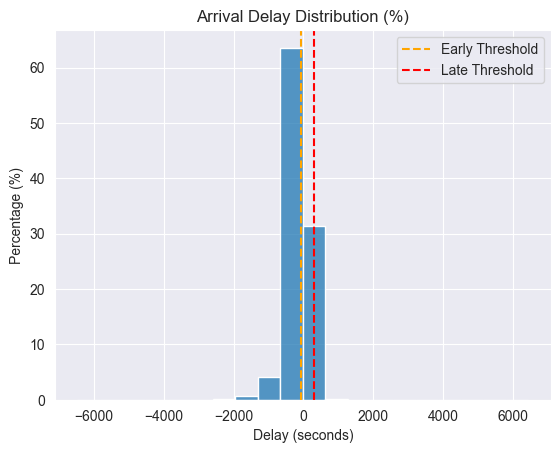

In [105]:
sns.histplot(route_601_2024["arrive_delay"], bins=50, stat="percent")
plt.axvline(-59, color='orange', linestyle='--', label='Early Threshold')
plt.axvline(300, color='red', linestyle='--', label='Late Threshold')
plt.legend()
plt.title("Arrival Delay Distribution (%)")
plt.xlabel("Delay (seconds)")
plt.ylabel("Percentage (%)")
plt.show()

<Axes: xlabel='dep_delay', ylabel='Count'>

Text(0.5, 1.0, 'Arrival Delay Distribution')

Text(0.5, 0, 'Delay (seconds)')

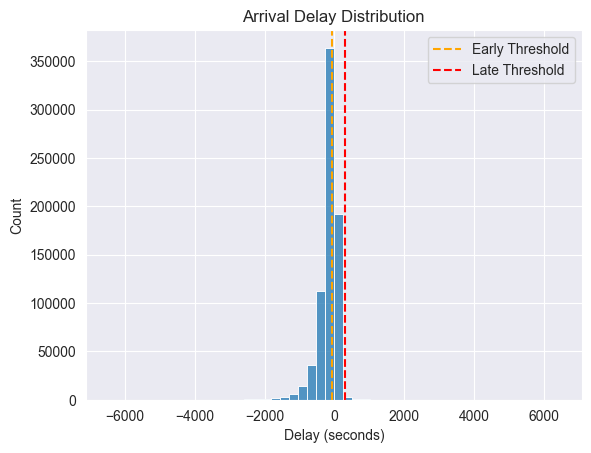

In [102]:
sns.histplot(route_601_2024["arrive_delay"], bins=50, stat="percent")
plt.axvline(-59, color='orange', linestyle='--', label='Early Threshold')
plt.axvline(300, color='red', linestyle='--', label='Late Threshold')
plt.legend()
plt.title("Arrival Delay Distribution (%)")
plt.xlabel("Delay (seconds)")
plt.ylabel("Percentage (%)")
plt.show()

In [78]:
route_601_2024["ACT_ARR_TIME_M"]=route_601_2024["ACT_ARR_TIME"].apply(fn_HH24MM)

In [79]:
route_601_2024["datetime"] = route_601_2024.apply(parse_time_with_date, axis=1)
route_601_2024["pattern_id"] = route_601_2024["PATTERN"].astype(str)
route_601_2024["stop_id"] = route_601_2024["STOPABBR"].astype(str)
route_601_2024["month"] = route_601_2024["datetime"].dt.month
route_601_2024["day_of_week"] = route_601_2024["datetime"].dt.dayofweek
route_601_2024["hour"] = route_601_2024["datetime"].dt.hour
route_601_2024["period"] = route_601_2024["hour"].apply(assign_period)
route_601_2024["is_weekday"] = route_601_2024["day_of_week"].apply(lambda x: 1 if x < 5 else 0)

In [80]:
route_601_2024

,ID,SIGNID,OPD_DATE,WEEKDAY,DIVISIONID,DIVISIONABBR,SERVICEGROUPID,SERVICEGROUPABBR,EXCCOMBOID,EXCCOMBOABBR,...,dep_label,ACT_ARR_TIME_M,datetime,pattern_id,stop_id,month,day_of_week,hour,period,is_weekday
0,5286840160,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,1,18:28:13,2024-01-01 18:28:13,601001,9779,1.0,0.0,18.0,3,1
1,5286840161,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,1,19:02:59,2024-01-01 19:02:59,601001,9802,1.0,0.0,19.0,4,1
2,5286840162,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,0,19:04:50,2024-01-01 19:04:50,601001,9804,1.0,0.0,19.0,4,1
3,5286840163,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,1,19:10:50,2024-01-01 19:10:50,601001,9806,1.0,0.0,19.0,4,1
4,5286840164,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,1,18:40:44,2024-01-01 18:40:44,601001,9787,1.0,0.0,18.0,3,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6532927,5928453161,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,1,22:39:36,2024-06-23 22:39:36,601002,9883,6.0,6.0,22.0,5,0
6532928,5928453162,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,1,22:37:05,2024-06-23 22:37:05,601002,2879428,6.0,6.0,22.0,5,0
6532929,5928453163,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,1,23:30:27,2024-06-23 23:30:27,601002,9776,6.0,6.0,23.0,5,0
6532930,5928453164,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,1,22:35:53,2024-06-23 22:35:53,601002,9809,6.0,6.0,22.0,5,0


In [81]:
delay_summary = (
    route_601_2024
    .groupby(['period', 'arrival_status'])
    .size()
    .unstack(fill_value=0)
    .reset_index()
)

<Axes: xlabel='period'>

Text(0.5, 1.0, 'Arrival Status by Period')

Text(0, 0.5, 'Number of Stops')

Text(0.5, 0, 'Period')

(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, '0'),
  Text(1, 0, '1'),
  Text(2, 0, '2'),
  Text(3, 0, '3'),
  Text(4, 0, '4'),
  Text(5, 0, '5')])

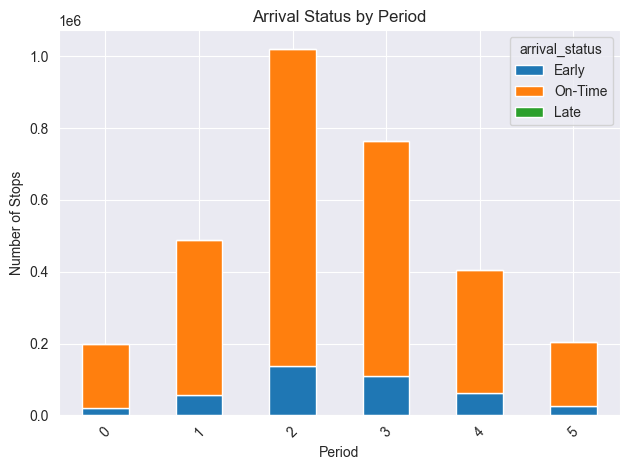

In [82]:
delay_summary.set_index('period')[['Early', 'On-Time', 'Late']].plot(kind='bar', stacked=True)
plt.title("Arrival Status by Period")
plt.ylabel("Number of Stops")
plt.xlabel("Period")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [83]:
delay_summary = (
    route_601_2024
    .groupby(['period', 'departure_status'])
    .size()
    .unstack(fill_value=0)
    .reset_index()
)

<Axes: xlabel='period'>

Text(0.5, 1.0, 'Departure Status by Period')

Text(0, 0.5, 'Number of Stops')

Text(0.5, 0, 'Period')

(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, '0'),
  Text(1, 0, '1'),
  Text(2, 0, '2'),
  Text(3, 0, '3'),
  Text(4, 0, '4'),
  Text(5, 0, '5')])

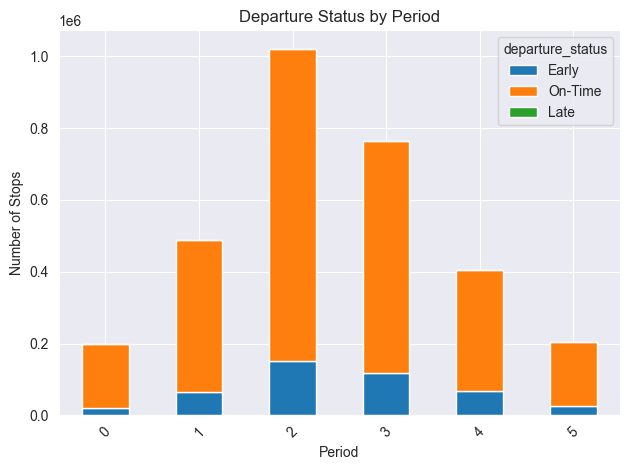

In [84]:
delay_summary.set_index('period')[['Early', 'On-Time', 'Late']].plot(kind='bar', stacked=True)
plt.title("Departure Status by Period")
plt.ylabel("Number of Stops")
plt.xlabel("Period")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [85]:
route_601_2024

,ID,SIGNID,OPD_DATE,WEEKDAY,DIVISIONID,DIVISIONABBR,SERVICEGROUPID,SERVICEGROUPABBR,EXCCOMBOID,EXCCOMBOABBR,...,dep_label,ACT_ARR_TIME_M,datetime,pattern_id,stop_id,month,day_of_week,hour,period,is_weekday
0,5286840160,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,1,18:28:13,2024-01-01 18:28:13,601001,9779,1.0,0.0,18.0,3,1
1,5286840161,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,1,19:02:59,2024-01-01 19:02:59,601001,9802,1.0,0.0,19.0,4,1
2,5286840162,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,0,19:04:50,2024-01-01 19:04:50,601001,9804,1.0,0.0,19.0,4,1
3,5286840163,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,1,19:10:50,2024-01-01 19:10:50,601001,9806,1.0,0.0,19.0,4,1
4,5286840164,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,1,18:40:44,2024-01-01 18:40:44,601001,9787,1.0,0.0,18.0,3,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6532927,5928453161,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,1,22:39:36,2024-06-23 22:39:36,601002,9883,6.0,6.0,22.0,5,0
6532928,5928453162,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,1,22:37:05,2024-06-23 22:37:05,601002,2879428,6.0,6.0,22.0,5,0
6532929,5928453163,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,1,23:30:27,2024-06-23 23:30:27,601002,9776,6.0,6.0,23.0,5,0
6532930,5928453164,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,1,22:35:53,2024-06-23 22:35:53,601002,9809,6.0,6.0,22.0,5,0


In [86]:
le_period=LabelEncoder()
le_pattern=LabelEncoder()
le_stop=LabelEncoder()
route_601_2024["period_encoded"]=le_period.fit_transform(route_601_2024["period"])
route_601_2024["pattern_encoded"]=le_pattern.fit_transform(route_601_2024["pattern_id"])
route_601_2024["stop_id"]=le_stop.fit_transform(route_601_2024["STOPABBR"])

In [87]:
route_601_2024

,ID,SIGNID,OPD_DATE,WEEKDAY,DIVISIONID,DIVISIONABBR,SERVICEGROUPID,SERVICEGROUPABBR,EXCCOMBOID,EXCCOMBOABBR,...,datetime,pattern_id,stop_id,month,day_of_week,hour,period,is_weekday,period_encoded,pattern_encoded
0,5286840160,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,2024-01-01 18:28:13,601001,21,1.0,0.0,18.0,3,1,3,0
1,5286840161,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,2024-01-01 19:02:59,601001,44,1.0,0.0,19.0,4,1,4,0
2,5286840162,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,2024-01-01 19:04:50,601001,46,1.0,0.0,19.0,4,1,4,0
3,5286840163,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,2024-01-01 19:10:50,601001,48,1.0,0.0,19.0,4,1,4,0
4,5286840164,138,2024-01-01,1_MON,1,DIV7,75,5_HOLSAT02,NaN,None,...,2024-01-01 18:40:44,601001,29,1.0,0.0,18.0,3,1,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6532927,5928453161,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,2024-06-23 22:39:36,601002,62,6.0,6.0,22.0,5,0,5,1
6532928,5928453162,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,2024-06-23 22:37:05,601002,8,6.0,6.0,22.0,5,0,5,1
6532929,5928453163,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,2024-06-23 23:30:27,601002,18,6.0,6.0,23.0,5,0,5,1
6532930,5928453164,140,2024-06-23,7_SUN,1,DIV7,3,3_SNHL,24598.0,06SUCW10,...,2024-06-23 22:35:53,601002,51,6.0,6.0,22.0,5,0,5,1


In [88]:
features=["period_encoded","pattern_encoded","is_weekday","month","BOARDING","ALIGHTING","stop_id"]
X=route_601_2024[features]
y_1=route_601_2024["arrival_label"]
y_2=route_601_2024["dep_label"]


In [89]:
# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y_1, test_size=0.3, random_state=42)
from sklearn.model_selection import GridSearchCV
from xgboost import XGBClassifier

param_grid = {
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.3],
    'n_estimators': [50, 100, 200],
    'subsample': [0.8, 1],
    'colsample_bytree': [0.8, 1],
    'scale_pos_weight': [1, 3, 9]  # for class imbalance
}

grid = GridSearchCV(
    estimator=XGBClassifier(use_label_encoder=False, eval_metric='logloss'),
    param_grid=param_grid,
    scoring='f1',  # or 'roc_auc', 'accuracy'
    cv=3,
    verbose=1,
    n_jobs=-1
)

grid.fit(X_train, y_train)
print("Best Params:", grid.best_params_)
print("Best F1 Score:", grid.best_score_)


Fitting 3 folds for each of 324 candidates, totalling 972 fits


C:\Users\mao75\Desktop\study\Rotman\Python\pythonProject\.venv\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:57:00] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


GridSearchCV(cv=3,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False,
                                     eval_metric='logloss', feature_types=None,
                                     feature_weights=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraint...
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None, ...),
             n_jobs=-1,
             param_grid={'colsample_bytree': [0.8, 1],
                         'learning_rate': [0.01, 0.1, 0.3],
                         'max_depth': [3, 5, 7], 'n_estimators': [50, 100, 200],
                         'scale_pos_weight': [1, 3, 9], 'subsample': [0.8, 1]},
             scoring='f1', verbose=1)

Best Params: {'colsample_bytree': 1, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200, 'scale_pos_weight': 1, 'subsample': 0.8}
Best F1 Score: 0.9559671051849971


In [96]:
# XGBoost model
model = XGBClassifier(n_estimators=200, max_depth=7, learning_rate=0.1, use_label_encoder=False, eval_metric='logloss',subsample=0.8,colsample_bylevel=1)
model.fit(X_train, y_train)

# Prediction and evaluation
y_pred = model.predict(X_test)
report = classification_report(y_test, y_pred, output_dict=True)
print(classification_report(y_test, y_pred))

C:\Users\mao75\Desktop\study\Rotman\Python\pythonProject\.venv\Lib\site-packages\xgboost\training.py:183: UserWarning: [23:59:56] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=1, colsample_bynode=None, colsample_bytree=None,
              device=None, early_stopping_rounds=None, enable_categorical=False,
              eval_metric='logloss', feature_types=None, feature_weights=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=200, n_jobs=None,
              num_parallel_tree=None, ...)

              precision    recall  f1-score   support

           0       0.64      0.42      0.51     84561
           1       0.94      0.98      0.96    840019

    accuracy                           0.93    924580
   macro avg       0.79      0.70      0.74    924580
weighted avg       0.92      0.93      0.92    924580



<Axes: title={'center': 'Feature importance'}, xlabel='Importance score', ylabel='Features'>

Text(0.5, 1.0, 'Feature Importance by Gain')

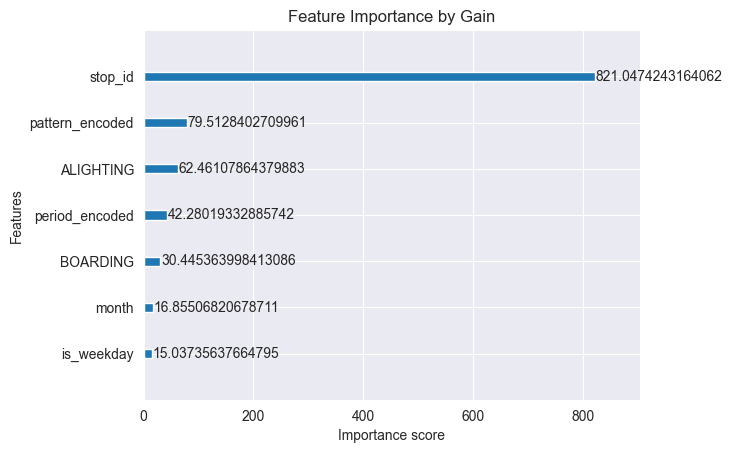

In [97]:

plot_importance(model, importance_type='gain')  # 'weight', 'gain', 'cover'
plt.title("Feature Importance by Gain")
plt.show()

In [98]:
X_train, X_test, y_train, y_test = train_test_split(X, y_2, test_size=0.3, random_state=42)
# XGBoost model
model = XGBClassifier(n_estimators=200, max_depth=7, learning_rate=0.1, use_label_encoder=False, eval_metric='logloss',subsample=0.8,colsample_bylevel=1)
model.fit(X_train, y_train)

# Prediction and evaluation
y_pred = model.predict(X_test)
report = classification_report(y_test, y_pred, output_dict=True)
print(classification_report(y_test, y_pred))

C:\Users\mao75\Desktop\study\Rotman\Python\pythonProject\.venv\Lib\site-packages\xgboost\training.py:183: UserWarning: [00:00:19] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=1, colsample_bynode=None, colsample_bytree=None,
              device=None, early_stopping_rounds=None, enable_categorical=False,
              eval_metric='logloss', feature_types=None, feature_weights=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=200, n_jobs=None,
              num_parallel_tree=None, ...)

              precision    recall  f1-score   support

           0       0.64      0.42      0.51     84561
           1       0.94      0.98      0.96    840019

    accuracy                           0.93    924580
   macro avg       0.79      0.70      0.74    924580
weighted avg       0.92      0.93      0.92    924580



<Axes: title={'center': 'Feature importance'}, xlabel='Importance score', ylabel='Features'>

Text(0.5, 1.0, 'Feature Importance by Gain')

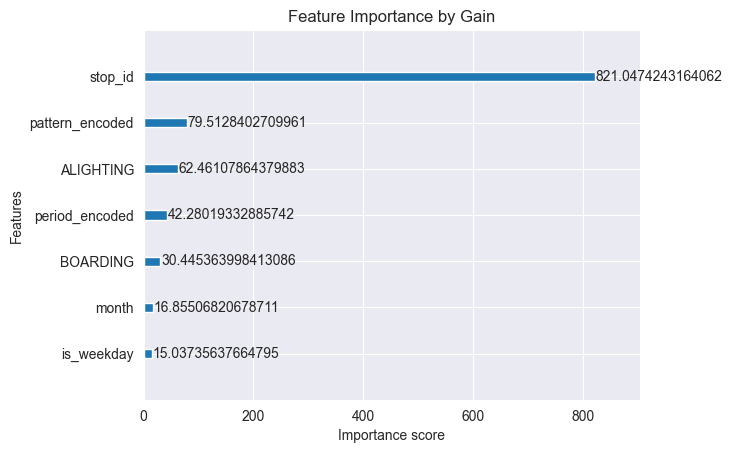

In [99]:
plot_importance(model, importance_type='gain')  # 'weight', 'gain', 'cover'
plt.title("Feature Importance by Gain")
plt.show()